In [31]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


In [32]:
df = pd.read_csv('https://gbcdn.mrgcdn.ru/uploads/asset/5367150/attachment/33d5eb785fb89460971028c60496e3f3.csv', sep=',')

In [33]:
df.head()

,Company,Product,TypeName,Inches,Cpu,Ram,Gpu,OpSys,Weight,Price_euros,Cpu_Company,Memory_Amount,Memory_Type
0,Apple,MacBook Pro,Ultrabook,13.3,Intel Core i5 2.3GHz,8GB,Intel Iris Plus Graphics 640,macOS,1.37,1339.69,Intel,128,SSD
1,Apple,Macbook Air,Ultrabook,13.3,Intel Core i5 1.8GHz,8GB,Intel HD Graphics 6000,macOS,1.34,898.94,Intel,128,FlashStorage
2,HP,250 G6,Notebook,15.6,Intel Core i5 7200U 2.5GHz,8GB,Intel HD Graphics 620,No OS,1.86,575.00,Intel,256,SSD
3,Apple,MacBook Pro,Ultrabook,15.4,Intel Core i7 2.7GHz,16GB,AMD Radeon Pro 455,macOS,1.83,2537.45,Intel,512,SSD
4,Apple,MacBook Pro,Ultrabook,13.3,Intel Core i5 3.1GHz,8GB,Intel Iris Plus Graphics 650,macOS,1.37,1803.60,Intel,256,SSD


### Задание 1.
- 1.1 Изучите количество памяти с помощью matplotlib



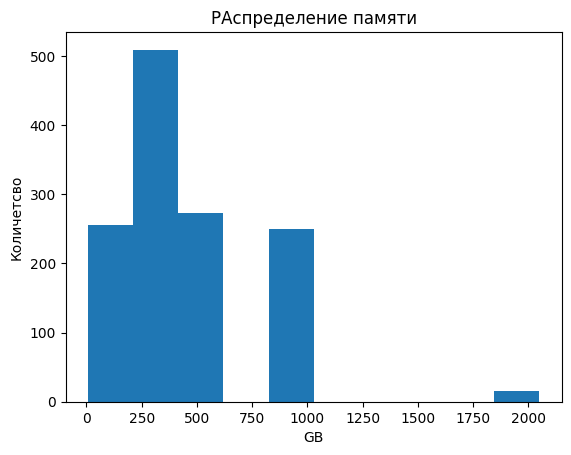

In [34]:
import matplotlib.pyplot as plt

plt.hist(df['Memory_Amount'])
plt.title('РАспределение памяти')
plt.xlabel('GB')
plt.ylabel('Количетсво');

- 1.2 Изучите стоимость ноутбуков с помощью matplotlib


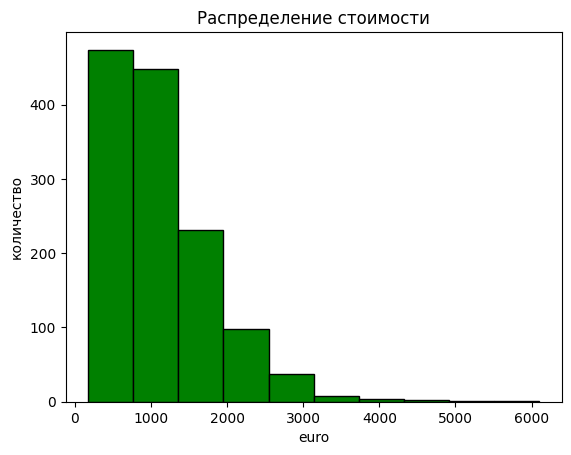

In [35]:
plt.hist(df['Price_euros'], color='green', edgecolor='black')
plt.title('Распределение стоимости')
plt.xlabel('euro')
plt.ylabel('количество');

- 1.3 Изучите вес ноутбуков с помощью matplotlib

Text(0, 0.5, 'количество')

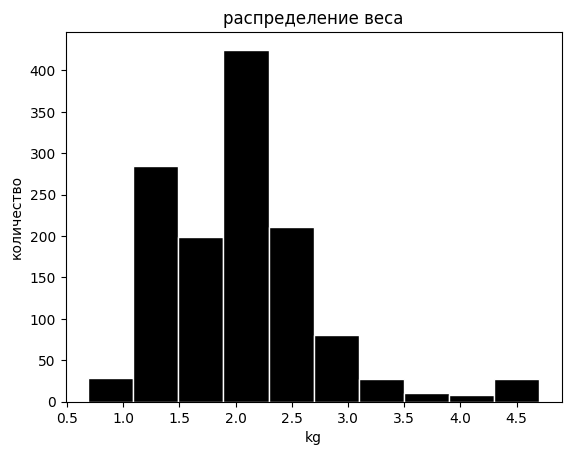

In [36]:
plt.hist(df['Weight'], color='#000000', edgecolor='white')
plt.title('распределение веса')
plt.xlabel('kg')
plt.ylabel('количество')

### Задание 2.
2.1 Изучите распределение типов носителя

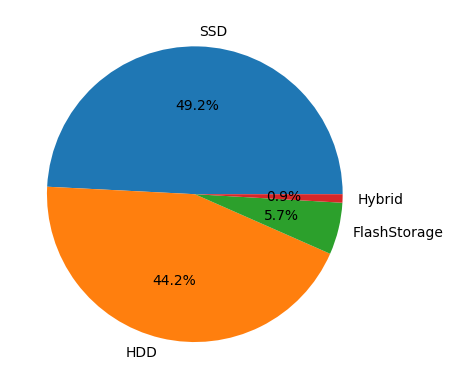

In [37]:
data = df['Memory_Type'].value_counts()
data
names = data.index
values = data.values
plt.pie(values, labels=names, autopct='%.1f%%');# можно сразу индекс и значение записать в значения

2.2 Изучите распределение компаний производителей


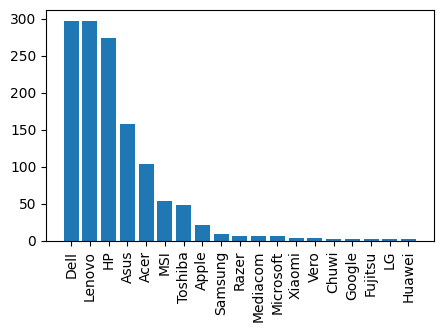

In [38]:
data = df['Company'].value_counts()
names = data.index
values = data.values

plt.figure(figsize=(5, 3))
plt.bar(names, values)
plt.xticks(rotation=90);

2.3 Изучите распределение операционной системы

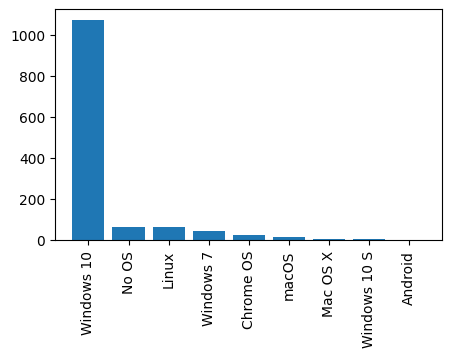

In [39]:
data = df['OpSys'].value_counts()
plt.figure(figsize=(5, 3))
plt.bar(data.index, data.values)
plt.xticks(rotation=90);

2.4 Изучите распределение компаний производителей CPU


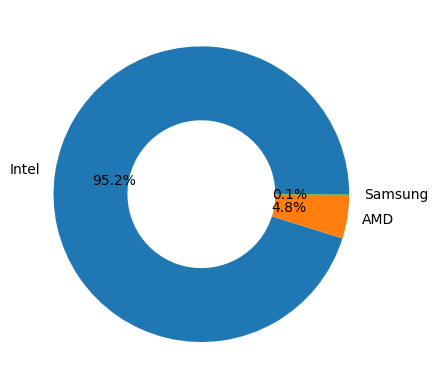

In [40]:
data = df['Cpu_Company'].value_counts()
plt.pie(data.values, labels=data.index, autopct='%.1f%%', wedgeprops=dict(width=0.5));

### Задание 3.
Изучите взаимосвязь компаний производителей ноутбуков и компаний производителей процессоров, используя сложенную или многорядовую столбчатую диаграмму
Процессоры от Samsung не изучайте

3.1 Постройте график в абсолютных величинах



In [41]:
import numpy as np

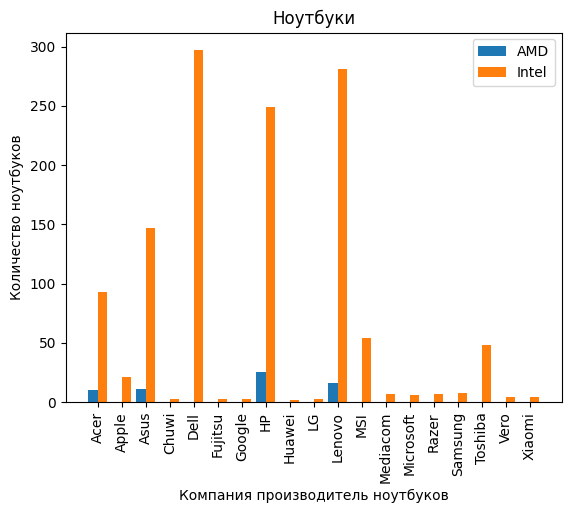

In [42]:
data = pd.crosstab(index=df['Company'], columns=df['Cpu_Company'])
data = data.drop(columns=['Samsung']).reset_index()
data

import numpy as np
n_ticks = np.arange(len(data['AMD']))
offset = 0.2
w = 0.4

plt.bar(n_ticks - offset, data['AMD'], width=w)
plt.bar(n_ticks + offset, data['Intel'], width=w)

plt.title('Ноутбуки')
plt.xlabel('Компания производитель ноутбуков')
plt.ylabel('Количество ноутбуков')
plt.legend(['AMD', 'Intel'])
plt.xticks(n_ticks, data['Company'], rotation=90);

3.2 Постройте график в относительных величинах


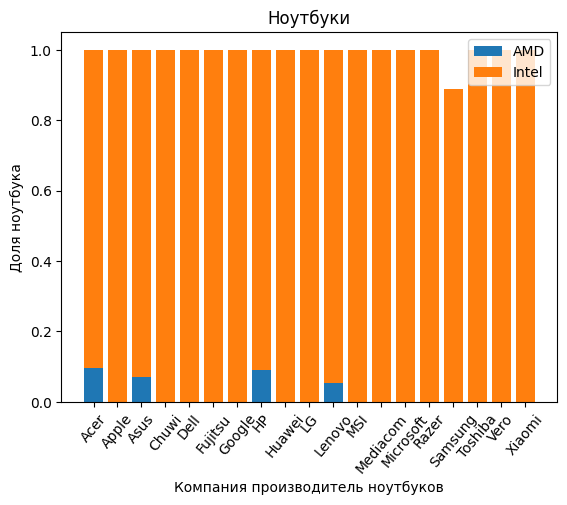

In [43]:
data = pd.crosstab(index=df['Company'], columns=df['Cpu_Company'], normalize='index')
data = data.drop(columns=['Samsung']).reset_index()
data

plt.bar(data['Company'], data['AMD'])
plt.bar(data['Company'], data['Intel'], bottom=data['AMD'])

plt.title('Ноутбуки')
plt.xlabel('Компания производитель ноутбуков')
plt.ylabel('Доля ноутбука')
plt.legend(['AMD', 'Intel'])
plt.xticks(rotation=50);



### Задание 4.
4.1 Изучите взаимосвязь стоимости ноутбука и компании производителя процессора

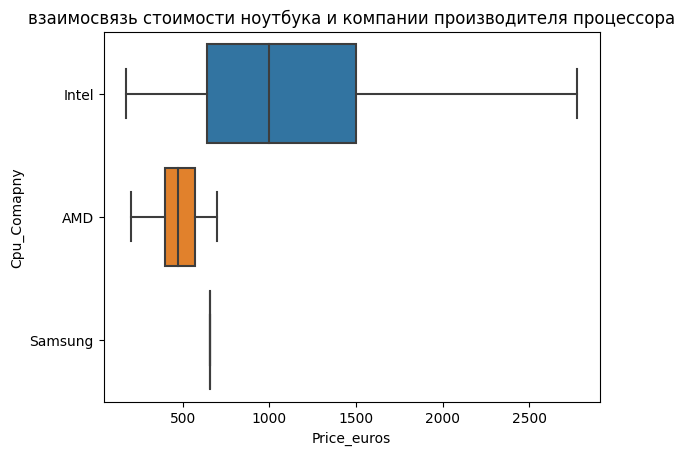

In [44]:
import seaborn as sns

sns.boxplot(x=df['Price_euros'], y=df['Cpu_Company'], showfliers=False)

plt.title('взаимосвязь стоимости ноутбука и компании производителя процессора')
plt.xlabel('Price_euros')
plt.ylabel('Cpu_Comapny');

4.2 Изучите взаимосвязь стоимости ноутбука и типа носителя памяти


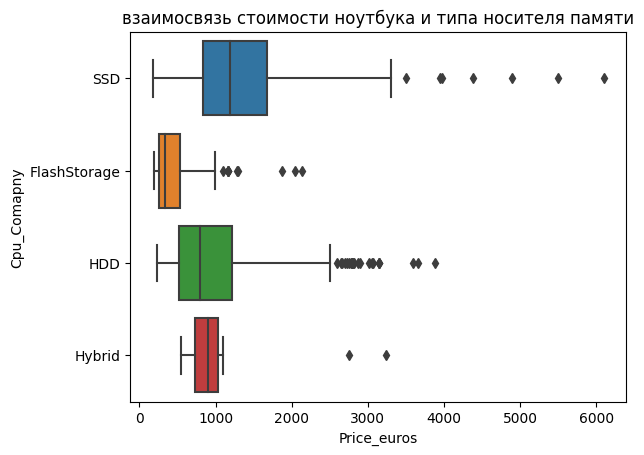

In [45]:
sns.boxplot(x=df['Price_euros'], y=df['Memory_Type'], whis=2)

plt.title('взаимосвязь стоимости ноутбука и типа носителя памяти')
plt.xlabel('Price_euros')
plt.ylabel('Cpu_Comapny');

4.3 Изучите взаимосвязь стоимости ноутбука и кол-ва оперативной памяти

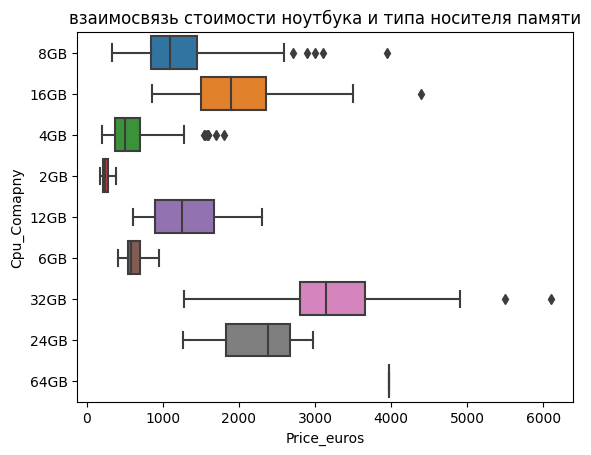

In [46]:
sns.boxplot(x=df['Price_euros'], y=df['Ram'], whis=2)

plt.title('взаимосвязь стоимости ноутбука и типа носителя памяти')
plt.xlabel('Price_euros')
plt.ylabel('Cpu_Comapny');

4.4 Изучите взаимосвязь стоимости ноутбука и компании производителя


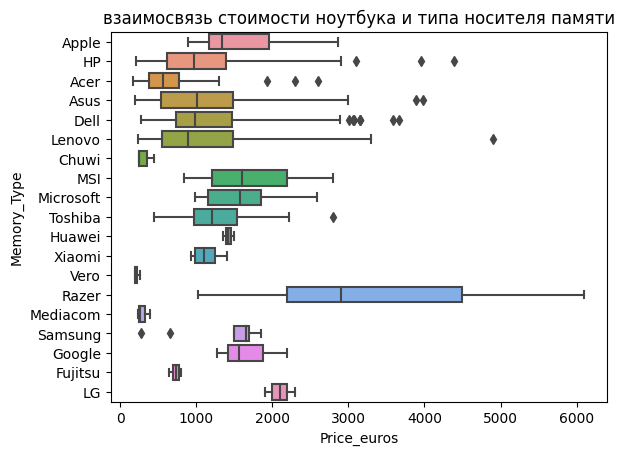

In [47]:
sns.boxplot(x=df['Price_euros'], y=df['Company'], whis=2)

plt.title('взаимосвязь стоимости ноутбука и типа носителя памяти')
plt.xlabel('Price_euros')
plt.ylabel('Memory_Type');

### Задание 5.
- Постройте матрицу корреляций для таблицы

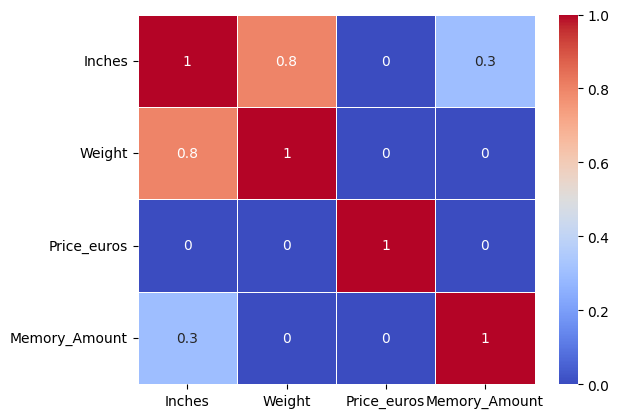

In [48]:
corr_matrix = df[['Inches', 'Weight', 'Price_euros', 'Memory_Amount']].corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix
sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm');

In [49]:
df.to_excel(r'') # функция перезаписи обработанного файла

ValueError: No engine for filetype: ''

In [51]:
df = pd.read_csv('https://gbcdn.mrgcdn.ru/uploads/asset/5367149/attachment/a8d3c3e5c671734c9cb5528120c2e715.csv', sep=',')

In [52]:
import folium
this_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(
        location=[point.lat, point.long],
        radius=2,
        popup=(point.price,
               point.floors)
    ).add_to(this_map)
    
df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map